In [1]:
import pandas as pd
import numpy as np
from ast import literal_eval
import geopandas as gpd
import plotly.express as px
import matplotlib.pyplot as plt
from shapely.geometry import Point
import json

### Reading data

In [2]:
rest_df = pd.read_csv('data/zomato_df_final_data.csv')
rest_df.head()

,address,cost,cuisine,lat,link,lng,phone,rating_number,rating_text,subzone,title,type,votes,groupon,color,cost_2,cuisine_color
0,"371A Pitt Street, CBD, Sydney",50.0,"['Hot Pot', 'Korean BBQ', 'BBQ', 'Korean']",-33.876059,https://www.zomato.com/sydney/sydney-madang-cbd,151.207605,02 8318 0406,4.0,Very Good,CBD,Sydney Madang,['Casual Dining'],1311.0,False,#e15307,5.243902,#6f706b
1,"Shop 7A, 2 Huntley Street, Alexandria, Sydney",80.0,"['Cafe', 'Coffee and Tea', 'Salad', 'Poké']",-33.910999,https://www.zomato.com/sydney/the-grounds-of-a...,151.193793,02 9699 2225,4.6,Excellent,"The Grounds of Alexandria, Alexandria",The Grounds of Alexandria Cafe,['Café'],3236.0,False,#9c3203,7.560976,#6f706b
2,"Level G, The Darling at the Star, 80 Pyrmont ...",120.0,['Japanese'],-33.867971,https://www.zomato.com/sydney/sokyo-pyrmont,151.195210,1800 700 700,4.9,Excellent,"The Star, Pyrmont",Sokyo,['Fine Dining'],1227.0,False,#7f2704,10.650407,#6f706b
3,"Sydney Opera House, Bennelong Point, Circular...",270.0,['Modern Australian'],-33.856784,https://www.zomato.com/sydney/bennelong-restau...,151.215297,02 9240 8000,4.9,Excellent,Circular Quay,Bennelong Restaurant,"['Fine Dining', 'Bar']",278.0,False,#7f2704,22.235772,#4186f4
4,"20 Campbell Street, Chinatown, Sydney",55.0,"['Thai', 'Salad']",-33.879035,https://www.zomato.com/sydney/chat-thai-chinatown,151.206409,02 8317 4811,4.5,Excellent,Chinatown,Chat Thai,['Casual Dining'],2150.0,False,#a83703,5.630081,#6f706b


### Data cleaning

In [3]:
# count na values
rest_df.isna().sum()

address             0
cost              346
cuisine             0
lat               192
link                0
lng               192
phone               0
rating_number    3316
rating_text      3316
subzone             0
title               0
type               48
votes            3316
groupon             0
color               0
cost_2            346
cuisine_color       0
dtype: int64

#### Dropping na values

In [4]:
rest_df = rest_df.dropna()
# rest_df.rating_number = rest_df.rating_number.fillna(rest_df.rating_number.median)

In [5]:
rest_df.isna().sum()

address          0
cost             0
cuisine          0
lat              0
link             0
lng              0
phone            0
rating_number    0
rating_text      0
subzone          0
title            0
type             0
votes            0
groupon          0
color            0
cost_2           0
cuisine_color    0
dtype: int64

### Convert string rows to list

In [51]:
rest_df.cuisine = rest_df.cuisine.apply(literal_eval)
rest_df.type = rest_df.type.apply(literal_eval)

### Dropping NA lat and long

In [5]:
rest_df = rest_df.dropna(subset=['lat', 'lng'])

### Convert lat and long to Point

In [6]:
# combine lat and long to Point
rest_df['geometry'] = rest_df.apply(lambda x: Point((float(x.lng), float(x.lat))), axis=1)

In [7]:
sydney_geo = gpd.read_file("data/sydney.geojson")

In [8]:
sydney_geo.head()

,SSC_CODE,SSC_NAME,CONF_VALUE,SQKM,geometry
0,10001,Abbotsbury,Very good,4.984673,"POLYGON ((150.85118 -33.87069, 150.85104 -33.8..."
1,10002,Abbotsford (NSW),Very good,1.017855,"POLYGON ((151.12593 -33.84578, 151.12678 -33.8..."
2,10010,Acacia Gardens,Very good,0.946630,"POLYGON ((150.90781 -33.73547, 150.90799 -33.7..."
3,10016,Airds,Very good,2.380773,"POLYGON ((150.84000 -34.07817, 150.84077 -34.0..."
4,10022,Alexandria,Very good,3.503330,"POLYGON ((151.18603 -33.91660, 151.18562 -33.9..."


### spatial join

In [16]:
# spatial join 2 dataframes
rest_gdf = gpd.GeoDataFrame(rest_df, geometry='geometry')
rest_gdf.crs = sydney_geo.crs
joined_gdf = gpd.sjoin(rest_gdf, sydney_geo, how='left', op='within')
joined_gdf.head()

NameError: name 'rest_df' is not defined

<Axes: >

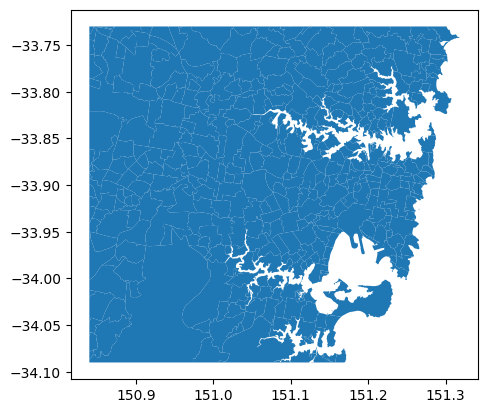

In [9]:
sydney_geo.plot()

In [10]:
sydney_geo['rest_count'] = 0
sydney_geo.head()

,SSC_CODE,SSC_NAME,CONF_VALUE,SQKM,geometry,rest_count
0,10001,Abbotsbury,Very good,4.984673,"POLYGON ((150.85118 -33.87069, 150.85104 -33.8...",0
1,10002,Abbotsford (NSW),Very good,1.017855,"POLYGON ((151.12593 -33.84578, 151.12678 -33.8...",0
2,10010,Acacia Gardens,Very good,0.946630,"POLYGON ((150.90781 -33.73547, 150.90799 -33.7...",0
3,10016,Airds,Very good,2.380773,"POLYGON ((150.84000 -34.07817, 150.84077 -34.0...",0
4,10022,Alexandria,Very good,3.503330,"POLYGON ((151.18603 -33.91660, 151.18562 -33.9...",0


## Making Frequency table

In [11]:
# reset index of rest_df
rest_df = rest_df.reset_index(drop=True)

# find count in all polygons
for i in range(len(rest_df)):
    matched_row_list = sydney_geo.index[sydney_geo.contains(rest_df.geometry[i])].tolist()
    if len(matched_row_list) > 0:
        sydney_geo.rest_count[matched_row_list[0]] += 1
    else:
        continue
        

sydney_geo.rest_count.head()

C:\Users\fazal_ix0ll8n\AppData\Local\Temp\ipykernel_13920\1022043032.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sydney_geo.rest_count[matched_row_list[0]] += 1


0     2
1     4
2     0
3     0
4    48
Name: rest_count, dtype: int64

In [17]:
rest_count_df = sydney_geo[['SSC_CODE', 'rest_count']]
rest_count_df.head()

,SSC_CODE,rest_count
0,10001,2
1,10002,4
2,10010,0
3,10016,0
4,10022,48


<Axes: >

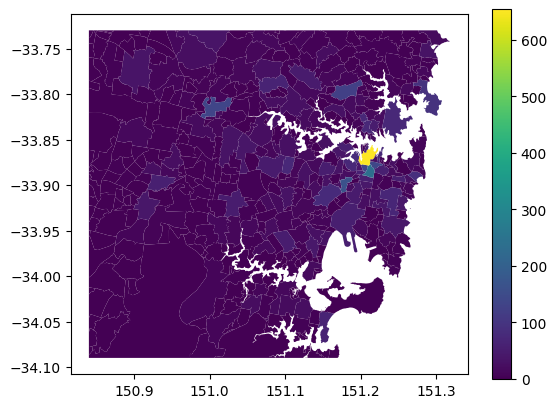

In [12]:
sydney_geo.plot(column="rest_count", legend=True)

In [14]:
sydney_geo.isna().sum()
# remove na values
sydney_geo = sydney_geo.dropna()
out_geo_file = sydney_geo[['SSC_CODE', 'geometry']]
out_geo_file.to_file("data/sydney_rest_count.geojson", driver='GeoJSON')

In [15]:
with open("data/sydney_rest_count.geojson", 'r') as infile:
    sydney_geo_json = json.load(infile)

### Plotting (Works on Browser) needed cleaning up

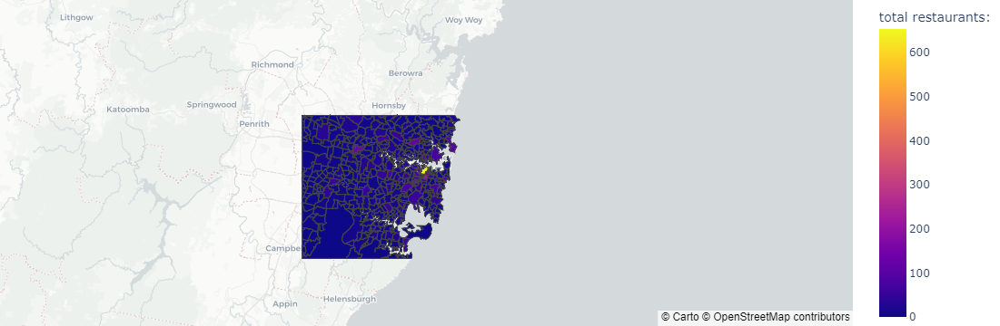

In [18]:
fig = px.choropleth_mapbox(rest_count_df, geojson=sydney_geo_json, locations="SSC_CODE", 
                           mapbox_style="carto-positron", 
                           featureidkey="properties.SSC_CODE",
                           labels={'rest_count':'total restaurants: '},
                           center = dict(lat= -33.85 , lon=151.2153),
                           color="rest_count")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [38]:
lga_json = sydney_geo.__geo_interface__

In [ ]:
fig = px.choropleth_mapbox(rest_count_df, geojson=sydney_geo_json, 
                           center = dict(lat= -19 , lon=145),
                           locations=rest_count_df.SSC_CODE, mapbox_style="carto-positron", color=rest_count_df["rest_count"])
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [24]:
fig = px.choropleth_mapbox(rest_count_df, geojson=lga_json, locations="SSC_CODE", featureidkey="properties.SSC_CODE", color="rest_count")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [18]:
fig2 = px.choropleth_mapbox(rest_count_df, geojson=sydney_geo_json, locations="SSC_CODE", featureidkey="properties.SSC_CODE", color="rest_count")
fig2.show()

In [19]:
px.set_mapbox_access_token("pk.eyJ1IjoiZmF6YWwtdWMiLCJhIjoiY2xtdGY4czE3MDNvdTJtbXNkc2pmamU0NSJ9.5RIWQbMJCDu81FZALk3cRw")

# Create a Plotly Express map
fig = px.choropleth_mapbox(
    geojson=sydney_geo_json,
    locations="SSC_CODE",
    color="your_color_column_name",
    hover_name="your_hover_name_column_name",
    mapbox_style="carto-positron",
    center={"lat": 0, "lon": 0},
    title="GeoPandas Data in Plotly Express",
)

ValueError: String or int arguments are only possible when a DataFrame or an array is provided in the `data_frame` argument. No DataFrame was provided, but argument 'hover_name' is of type str or int.

In [20]:
fig = px.choropleth(rest_count_df,
                    geojson=sydney_geo_json,
                    color='rest_count',
                    hover_name='SSC_CODE',
                    title='Choropleth Map')

In [ ]:

fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [5]:
fig.show()

In [ ]:
fig

In [17]:
syd_poly = sydney_geo.geometry
fig = px.choropleth_mapbox(sydney_geo,
                           geojson=syd_poly,
                           locations=sydney_geo.SSC_CODE,
                           color='CONF_VALUE',
                           hover_name='SSC_NAME',
                           title='Choropleth Map',
                           mapbox_style='carto-positron',
                           zoom=9,
                           center={'lat': -33.8688, 'lon': 151.2093},
                           opacity=0.5)


NameError: name 'sydney_geo' is not defined

In [19]:
fig.show()

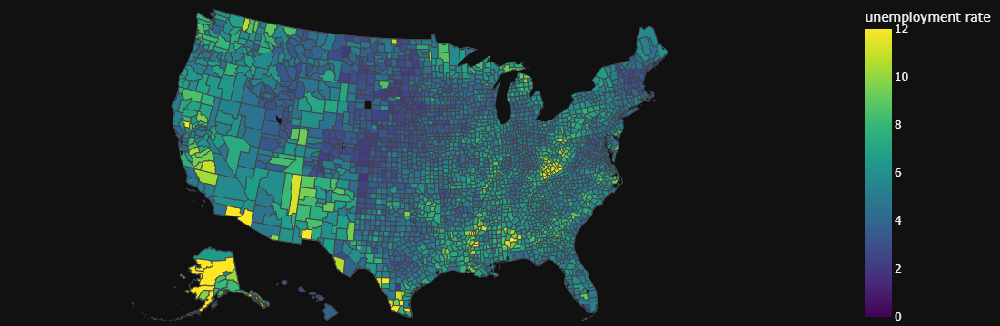

In [13]:
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

import pandas as pd
df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv",
                   dtype={"fips": str})

fig = px.choropleth(df, geojson=counties, locations='fips', color='unemp',
                           color_continuous_scale="Viridis",
                           range_color=(0, 12),
                           scope="usa",
                           labels={'unemp':'unemployment rate'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

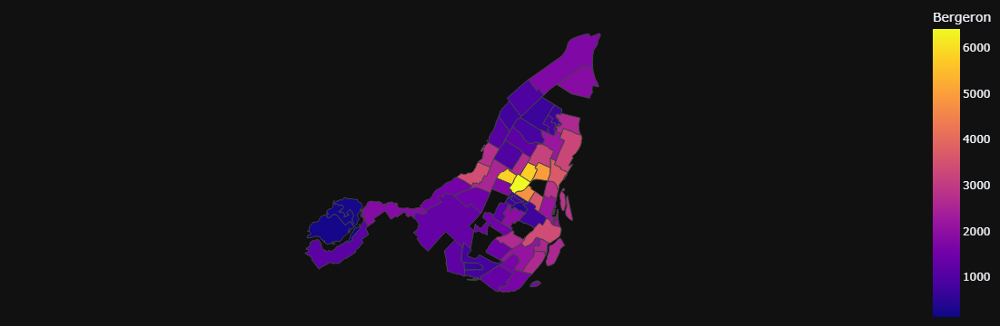

In [14]:
df = px.data.election()
geojson = px.data.election_geojson()

fig = px.choropleth(df, geojson=geojson, color="Bergeron",
                    locations="district", featureidkey="properties.district",
                    projection="mercator"
                   )
fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [10]:
geojson

{'type': 'FeatureCollection',
 'features': [{'type': 'Feature',
   'geometry': {'type': 'MultiPolygon',
    'coordinates': [[[[-73.6363215300962, 45.5759177646435],
       [-73.6362833815582, 45.5758266113331],
       [-73.6446417578686, 45.5658132919643],
       [-73.6453511352974, 45.5647725775888],
       [-73.648867564748, 45.5586898267402],
       [-73.6513170845065, 45.5545659435652],
       [-73.6515658357324, 45.5554439857955],
       [-73.6660837831645, 45.5596724837829],
       [-73.6706609041685, 45.5610978251999],
       [-73.6676019919116, 45.5632340862888],
       [-73.6645385824068, 45.5642716484367],
       [-73.663663123697, 45.5654269638586],
       [-73.663336397858, 45.5666288247853],
       [-73.6637764768649, 45.5678900619231],
       [-73.6625073244826, 45.5688479494114],
       [-73.6624620526633, 45.5708304456346],
       [-73.6620201425015, 45.5713925326191],
       [-73.6616100197742, 45.5737924780218],
       [-73.6612199500215, 45.5747171555678],
       [-7

<Axes: >

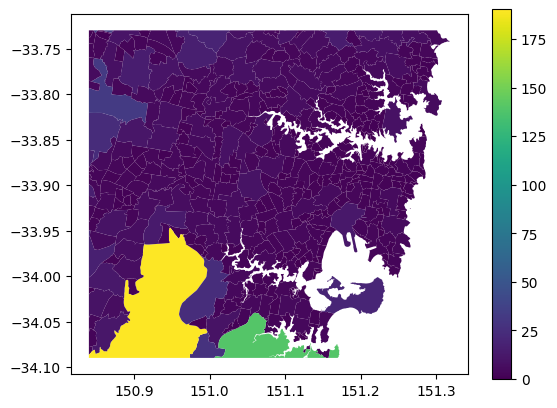

In [9]:
sydney_geo.plot(column="SQKM", legend=True)

#### demo codes

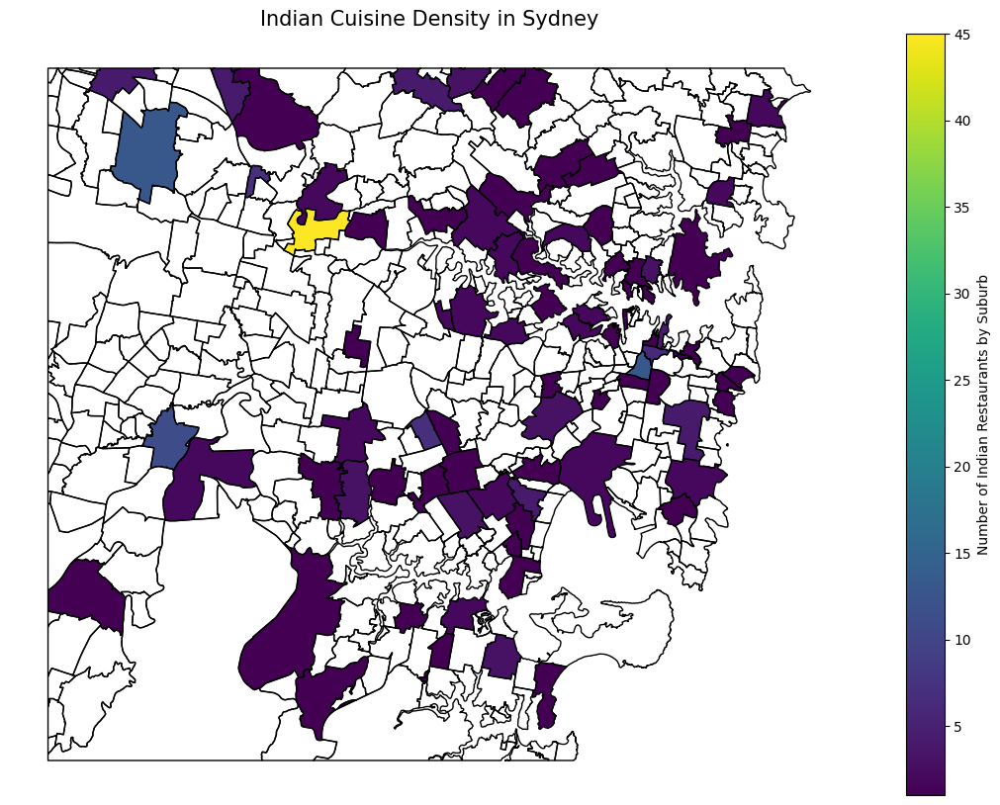

In [4]:
rest_data = df
rest_data['cuisine'] = rest_data['cuisine'].astype(str).fillna("Unknown")

# Extracting and flattening the list of cuisines
cuisines_list = rest_data['cuisine'].str.strip("[]").str.replace("'", "").str.split(", ")
all_cuisines = [cuisine for sublist in cuisines_list for cuisine in sublist]
unique_cuisines = set(all_cuisines)

# Create a function to calculate the density of each cuisine in each suburb
def calculate_cuisine_density(cuisine):
    mask = rest_data['cuisine'].str.contains(cuisine, case=False, na=False)
    return rest_data[mask]['subzone'].value_counts()

# Create a dictionary to store density data for each cuisine
cuisine_density_dict = {}
for cuisine in unique_cuisines:
    cuisine_density_dict[cuisine] = calculate_cuisine_density(cuisine)

# Display sample data for a specific cuisine (e.g., "Indian")
cuisine_density_dict.get('Indian', "No data available")

# Reload the sydney.geojson file
sydney_gdf = gpd.read_file("data/sydney.geojson")

# Display the first few rows of the geojson data
sydney_gdf.head()

def show_cuisine_densitymap(cuisine='Indian'):
    # Fetch the density data for the specified cuisine
    density_data = cuisine_density_dict.get(cuisine, None)
    if density_data is None:
        print(f"No data available for {cuisine} cuisine.")
        return
    
    # Merge the density data with the geojson data
    merged_gdf = sydney_gdf.set_index('SSC_NAME').join(density_data.rename(cuisine)).reset_index()
    
    # Plotting
    fig, ax = plt.subplots(1, 1, figsize=(15, 10))
    merged_gdf.boundary.plot(ax=ax, linewidth=1, color='black')
    merged_gdf.plot(column=cuisine, ax=ax, legend=True, cmap='viridis', 
                    legend_kwds={'label': f"Number of {cuisine} Restaurants by Suburb"})
    
    ax.set_title(f"{cuisine} Cuisine Density in Sydney", fontdict={'fontsize': '15', 'fontweight' : '3'})
    plt.axis('off')
    plt.show()

# Display the cuisine density map for Indian cuisine as a test
show_cuisine_densitymap(cuisine='Indian')